## Задание 5

Обучить детектор объектов с помощью TensorFlow Object Detection API       
Библиотеки: [Python, Tensorflow]  

https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/training.html  
https://neptune.ai/blog/how-to-train-your-own-object-detector-using-tensorflow-object-detection-api  
https://storage.googleapis.com/openimages/web/factsfigures_v5.html

### Подключение библиотек и скриптов

In [1]:
# For local Jupyter Notebook 
from IPython.core.display import display, HTML, Image
display(HTML('<style>.container { width:72.5% !important; }</style>'))

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
# For Google Colaboratory
%tensorflow_version 2.x

In [4]:
# For running inference on the TF-Hub module.
import tensorflow as tf

import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
plt.rcParams.update({'font.size': 14})
pd.set_option('precision', 3)
pd.set_option('max_columns', 100)
pd.set_option('display.float_format', lambda x: '%.5f' % x)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)
pd.set_option('max_colwidth', 300)

### Tensorflow with GPU

In [6]:
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
    raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


### TensorFlow Object Detection API

In [7]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix='.jpg')
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert('RGB')
  pil_image_rgb.save(filename, format='JPEG', quality=90)
  print('Image downloaded to %s.' % filename)
  if display:
    display_image(pil_image)
  return filename


def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=2,
                               display_str_list=()):
  '''Adds a bounding box to an image.'''
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill='black',
              font=font)
    text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.45):
  '''Overlay labeled boxes on an image with formatted scores and label names.'''
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf',
                              20)
  except IOError:
    print('Font not found, using default font.')
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = '{}: {}%'.format(class_names[i].decode('ascii'),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert('RGB')
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

Image downloaded to /tmp/tmp0352q_sr.jpg.


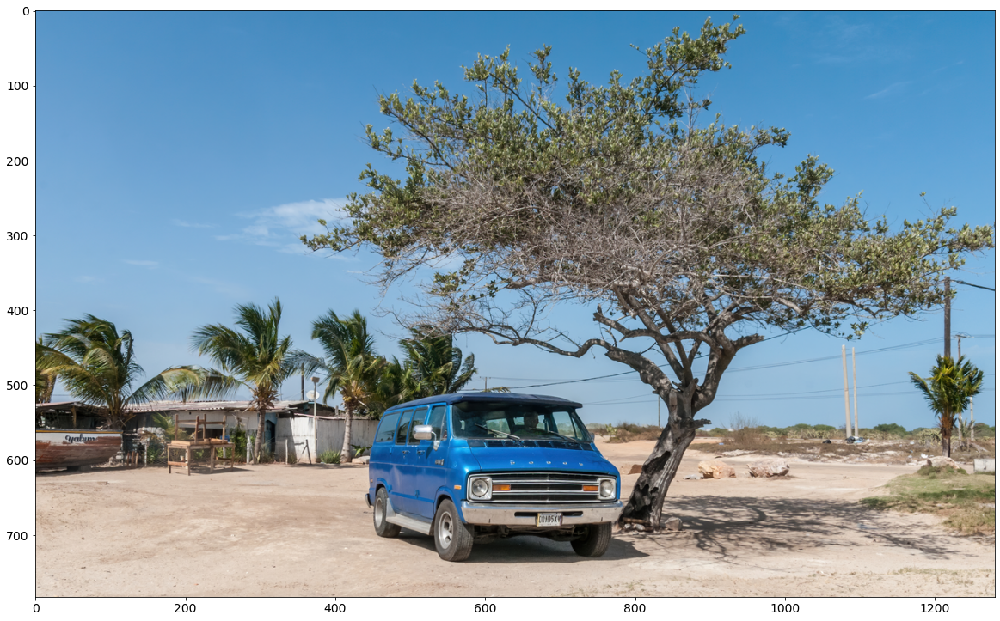

In [8]:
# Source: https://commons.wikimedia.org/wiki/File:Dodge_Ram_in_Margarita_Island.jpg
image_url = 'https://upload.wikimedia.org/wikipedia/commons/a/ae/Dodge_Ram_in_Margarita_Island.jpg' 
downloaded_image_path = download_and_resize_image(image_url, 1280, 783, True)

### FasterRCNN+InceptionResNetV2 network trained on Open Images V4.

The module performs non-maxima suppression inside the module. The maximal number of detection outputted is 100. Detections are outputted for 600 boxable categories.

In [9]:
module_handle = 'https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1'

detector = hub.load(module_handle).signatures['default']

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [10]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [11]:
def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print('Found %d objects.' % len(result['detection_scores']))
  print('Inference time: ', end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result['detection_boxes'],
      result['detection_class_entities'], result['detection_scores'])

  display_image(image_with_boxes)

Found 100 objects.
Inference time:  39.07072043418884


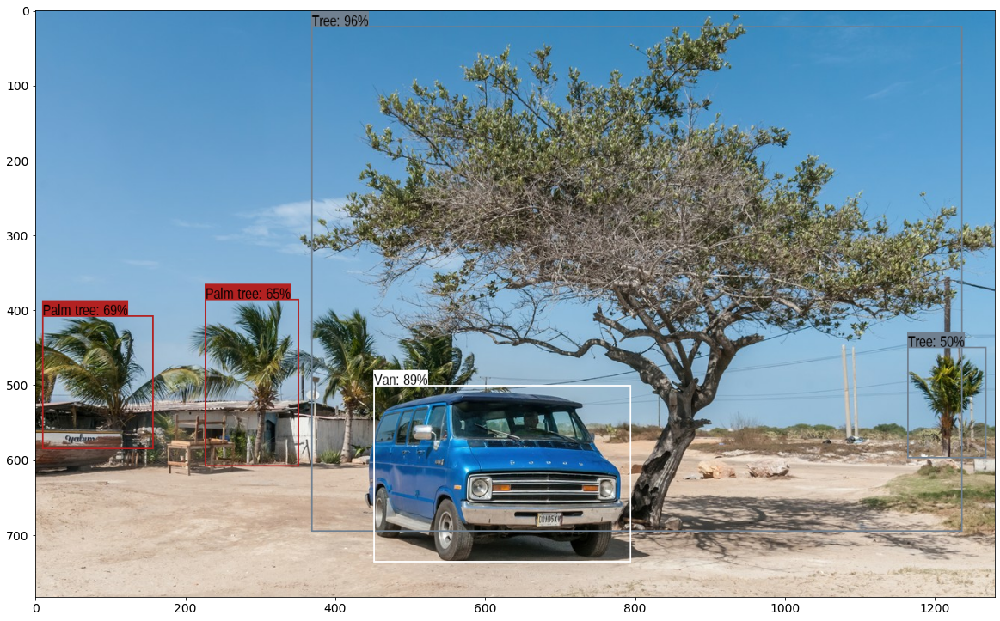

In [12]:
run_detector(detector, downloaded_image_path)

In [13]:
image_urls = [
  # Source: https://commons.wikimedia.org/wiki/File:Rotkehlchen_im_Landschaftsschutzgebiet_%22Unterer_Neckar,_Zwischen_Heidelberg_und_Ladenburg%22_04.jpg
  'https://upload.wikimedia.org/wikipedia/commons/e/e4/Rotkehlchen_im_Landschaftsschutzgebiet_%22Unterer_Neckar%2C_Zwischen_Heidelberg_und_Ladenburg%22_04.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:Sergeant_Major_fish_or_p%C3%ADntano_(Abudefduf_saxatilis)_a_species_of_damselfish_in_Curacao.jpg
  'https://upload.wikimedia.org/wikipedia/commons/1/16/Sergeant_Major_fish_or_p%C3%ADntano_%28Abudefduf_saxatilis%29_a_species_of_damselfish_in_Curacao.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:Boletus_reticulatus_2019_G03.jpg
  'https://upload.wikimedia.org/wikipedia/commons/1/15/Boletus_reticulatus_2019_G03.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:M%C3%BCnster,_Wolbeck,_Johannes_Blumenfelder,_Tulpen_--_2021_--_7843.jpg
  'https://upload.wikimedia.org/wikipedia/commons/9/99/M%C3%BCnster%2C_Wolbeck%2C_Johannes_Blumenfelder%2C_Tulpen_--_2021_--_7843.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:Quebec_ville,_Canada_06.jpg
  'https://upload.wikimedia.org/wikipedia/commons/f/fd/Quebec_ville%2C_Canada_06.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:17-05-06-Miniaturen_RR79036.jpg
  'https://upload.wikimedia.org/wikipedia/commons/f/fc/17-05-06-Miniaturen_RR79036.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:F_HLF_F2608_CPBMP.jpg
  'https://upload.wikimedia.org/wikipedia/commons/4/4e/F_HLF_F2608_CPBMP.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:GIMS_2019,_Le_Grand-Saconnex_(GIMS0591).jpg
  'https://upload.wikimedia.org/wikipedia/commons/5/54/GIMS_2019%2C_Le_Grand-Saconnex_%28GIMS0591%29.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:River_Kwai_Bridge_Railway_Station.jpg
  'https://upload.wikimedia.org/wikipedia/commons/6/61/River_Kwai_Bridge_Railway_Station.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:20190303_FIS_NWSC_Seefeld_Men_CC_50km_Mass_Start_850_7159.jpg
  'https://upload.wikimedia.org/wikipedia/commons/d/d8/20190303_FIS_NWSC_Seefeld_Men_CC_50km_Mass_Start_850_7159.jpg',

  # Source: https://commons.wikimedia.org/wiki/File:20180929_UCI_Road_World_Championships_Innsbruck_Women_Elite_Road_Race_Anna_van_der_Breggen_850_0990.jpg
  'https://upload.wikimedia.org/wikipedia/commons/e/e1/20180929_UCI_Road_World_Championships_Innsbruck_Women_Elite_Road_Race_Anna_van_der_Breggen_850_0990.jpg',
  ]

In [14]:
def detect_img(image_url):
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detector(detector, image_path)
  end_time = time.time()
  print('Inference time:', end_time-start_time)

Image downloaded to /tmp/tmphz6kjoal.jpg.
Found 100 objects.
Inference time:  1.3292531967163086
Inference time: 2.181079149246216


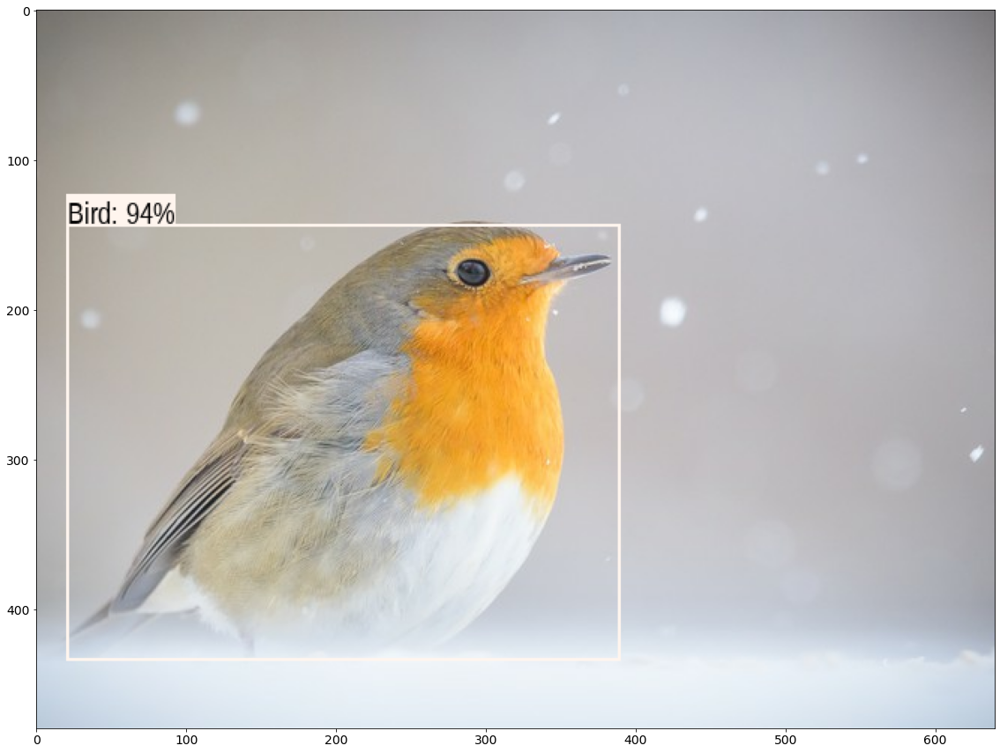

In [15]:
detect_img(image_urls[0])

Image downloaded to /tmp/tmp2aoougjn.jpg.
Found 100 objects.
Inference time:  0.8730959892272949
Inference time: 1.3339612483978271


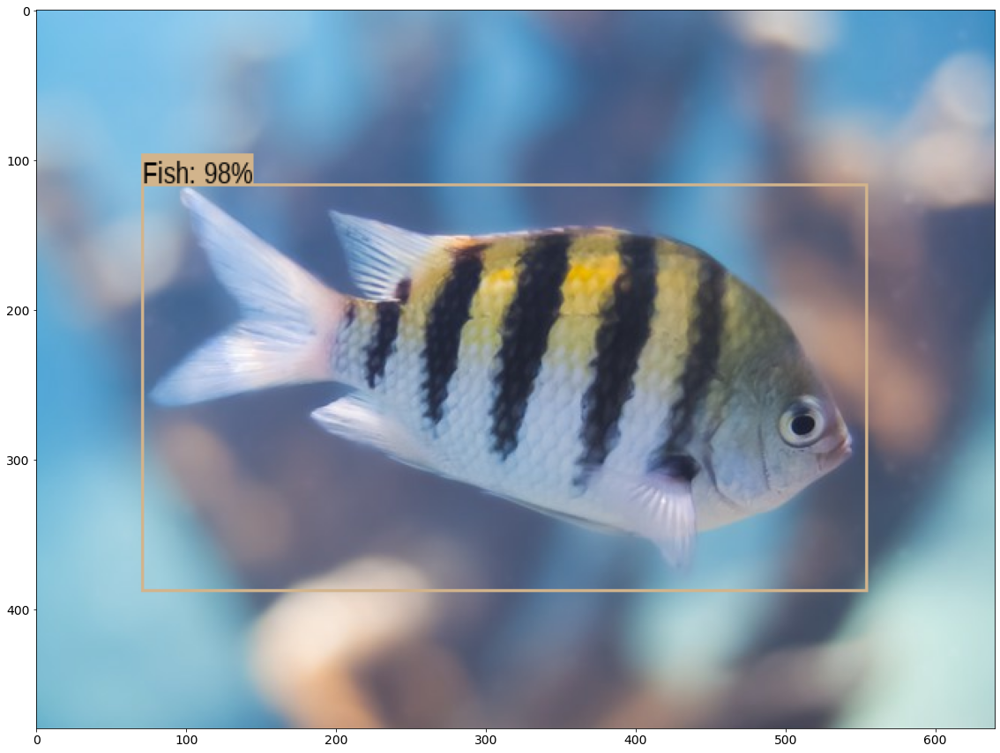

In [16]:
detect_img(image_urls[1])

Image downloaded to /tmp/tmp_sxnpxtr.jpg.
Found 100 objects.
Inference time:  0.8617191314697266
Inference time: 1.8516411781311035


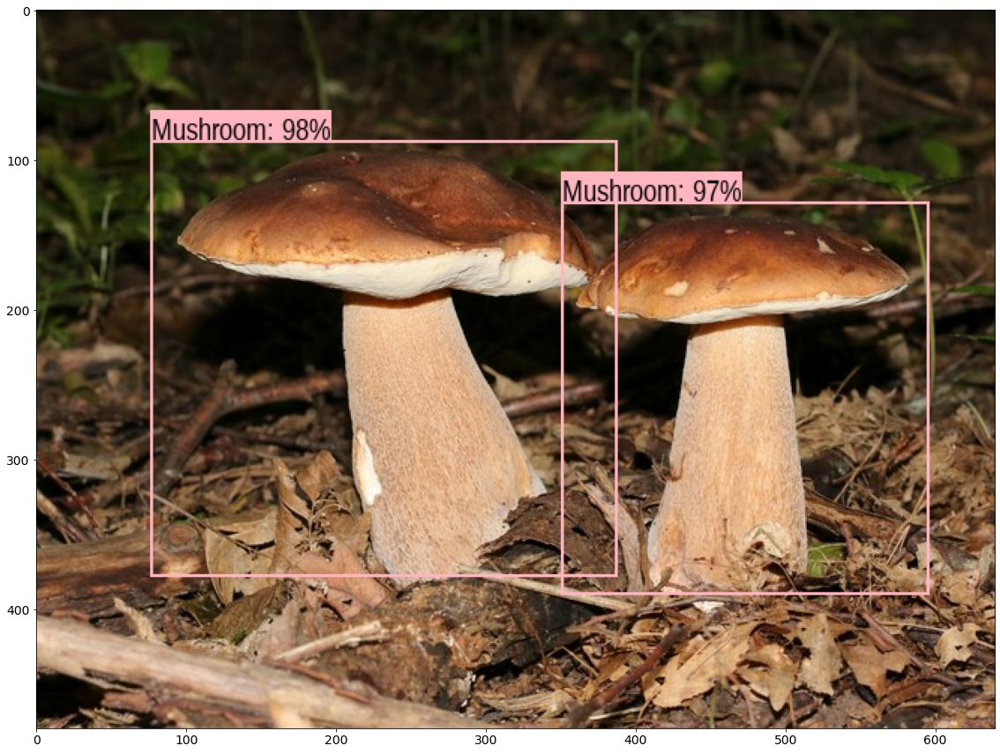

In [17]:
detect_img(image_urls[2])

Image downloaded to /tmp/tmp958y0iju.jpg.
Found 100 objects.
Inference time:  0.8639986515045166
Inference time: 2.384479522705078


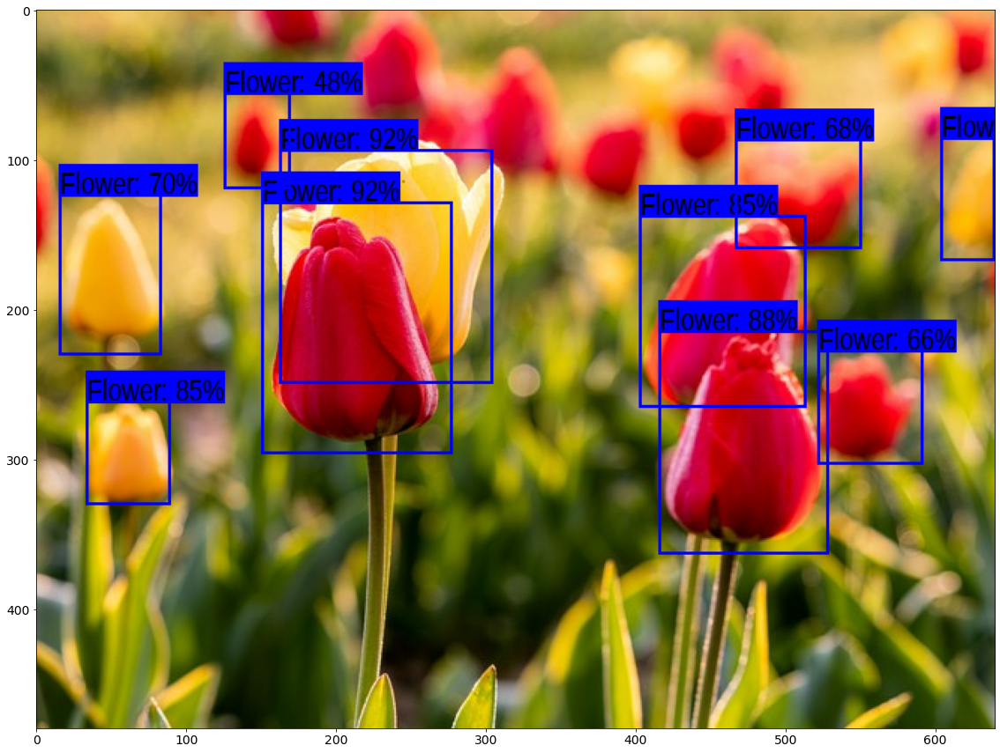

In [18]:
detect_img(image_urls[3])

Image downloaded to /tmp/tmpx7uc3z5r.jpg.
Found 100 objects.
Inference time:  0.8546335697174072
Inference time: 1.5017712116241455


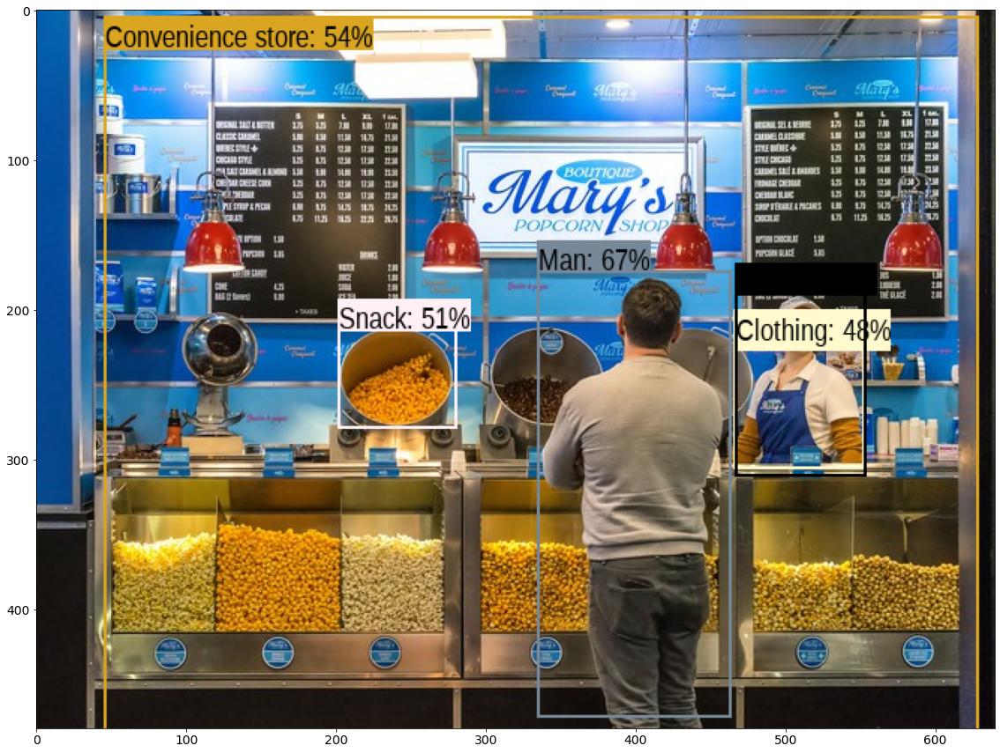

In [19]:
detect_img(image_urls[4])

Image downloaded to /tmp/tmpt6qx8qu9.jpg.
Found 100 objects.
Inference time:  0.8549799919128418
Inference time: 1.7958004474639893


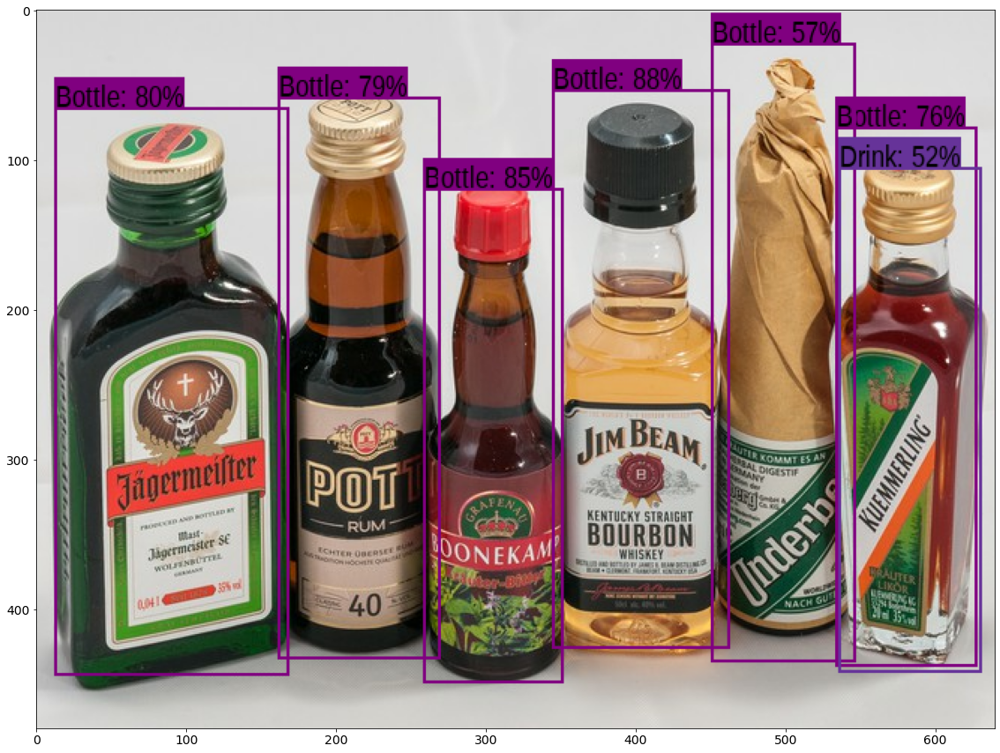

In [20]:
detect_img(image_urls[5])

Image downloaded to /tmp/tmpgzsz27s7.jpg.
Found 100 objects.
Inference time:  0.8585729598999023
Inference time: 1.9514436721801758


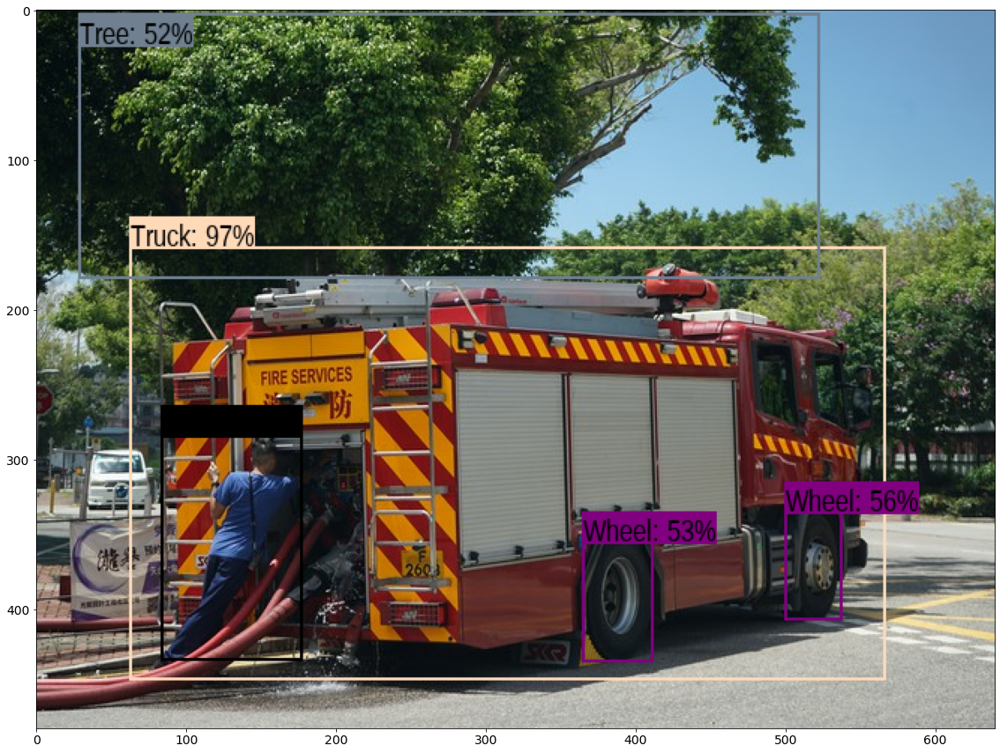

In [21]:
detect_img(image_urls[6])

Image downloaded to /tmp/tmpqa6kagui.jpg.
Found 100 objects.
Inference time:  0.8502883911132812
Inference time: 2.1654322147369385


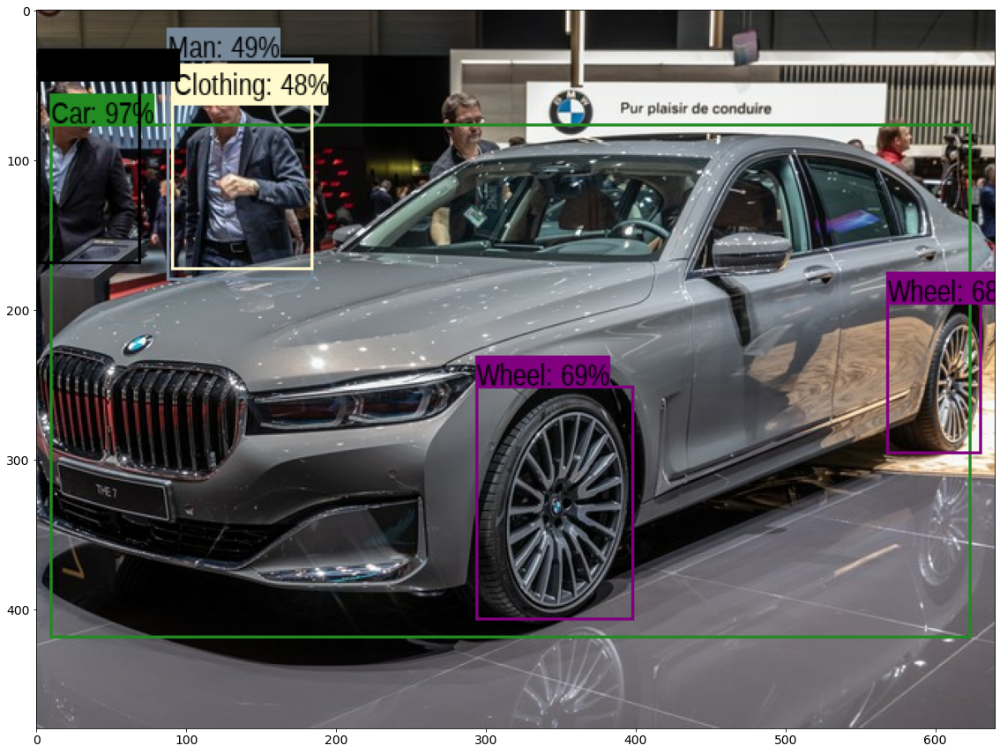

In [22]:
detect_img(image_urls[7])

Image downloaded to /tmp/tmpqlfddu0b.jpg.
Found 100 objects.
Inference time:  0.8767039775848389
Inference time: 2.1519765853881836


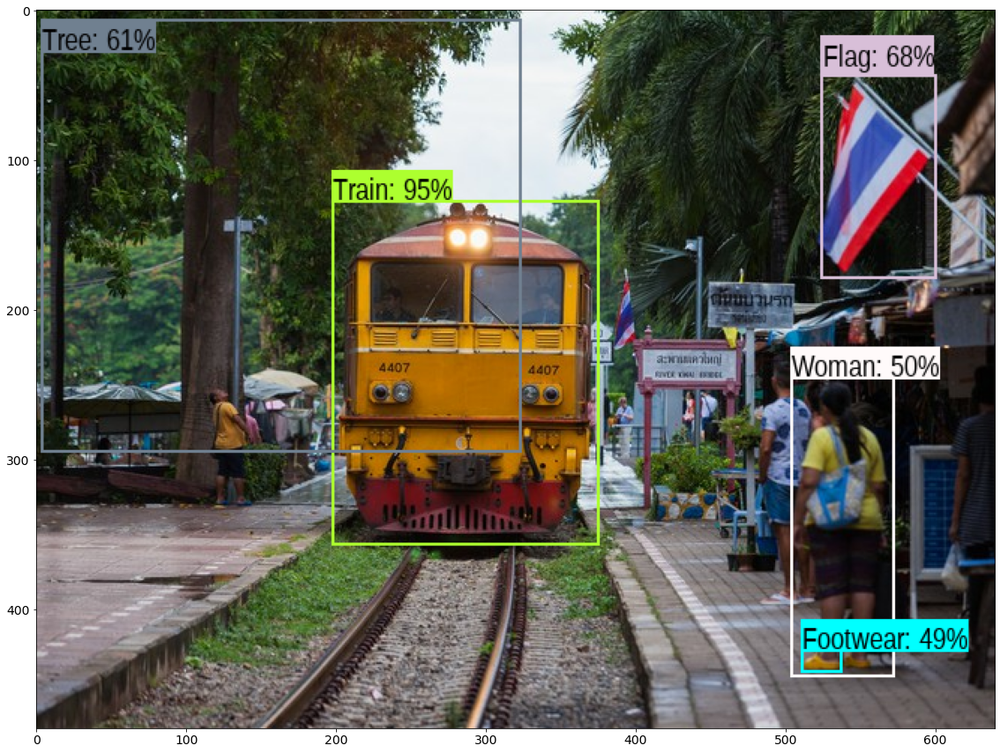

In [23]:
detect_img(image_urls[8])

Image downloaded to /tmp/tmpw9ijnlqj.jpg.
Found 100 objects.
Inference time:  0.8672065734863281
Inference time: 2.1540400981903076


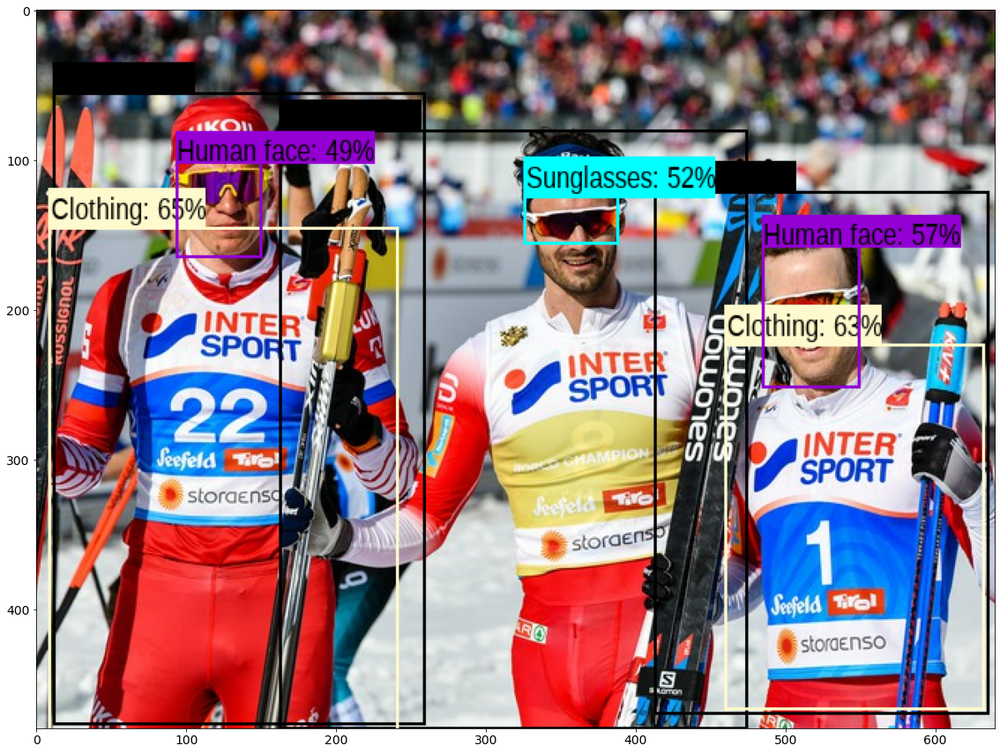

In [24]:
detect_img(image_urls[9])

Image downloaded to /tmp/tmpzp35ni9r.jpg.
Found 100 objects.
Inference time:  0.8638894557952881
Inference time: 2.182128667831421


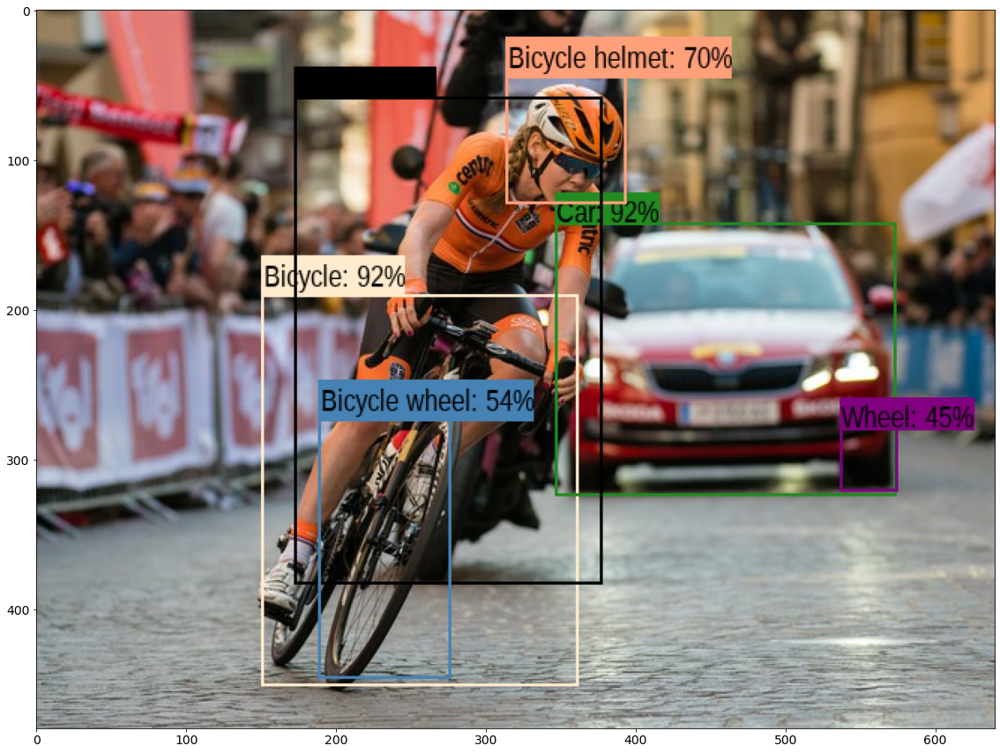

In [25]:
detect_img(image_urls[10])

### YOLOv5 | PyTorch

In [28]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt  # install dependencies

import torch
from IPython.display import Image, clear_output  # to display images

clear_output()
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 1.9.0+cu102 (Tesla P100-PCIE-16GB)


In [29]:
# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5l')  # or yolov5m, yolov5x, custom

requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master



requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



In [30]:
!python detect.py --weights yolov5l.pt --img 640 --conf 0.45 --source /content/yolov5/data/my_image

detect: weights=['yolov5l.pt'], source=/content/yolov5/data/my_image, imgsz=640, conf_thres=0.45, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Model Summary: 392 layers, 47025981 parameters, 0 gradients
image 1/12 /content/yolov5/data/my_im

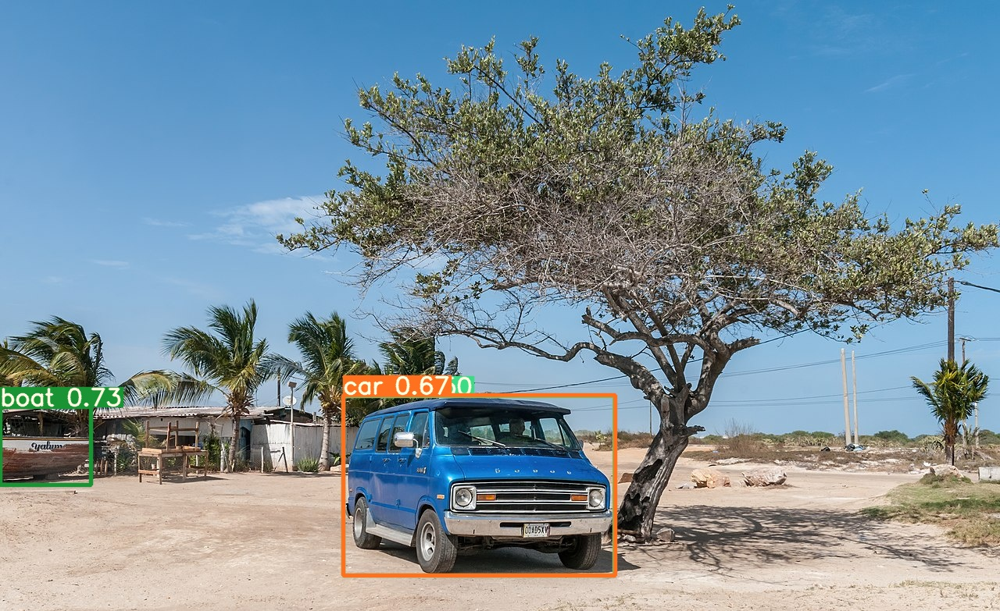

In [31]:
image_01 = 'runs/detect/exp/01_1280px-Dodge_Ram_in_Margarita_Island.jpg'
Image(filename=image_01)

In [32]:
# Inference
results_01 = model(image_01)

# Results
results_01.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_01.xyxy[0]  # img1 predictions (tensor)
results_01.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 783x1280 1 car, 1 truck
Speed: 31.6ms pre-process, 32.3ms inference, 2.1ms NMS per image at shape (1, 3, 416, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,439.00000,504.50000,785.00000,735.50000,0.53418,2,car
1,440.00000,505.00000,785.00000,736.00000,0.48950,7,truck


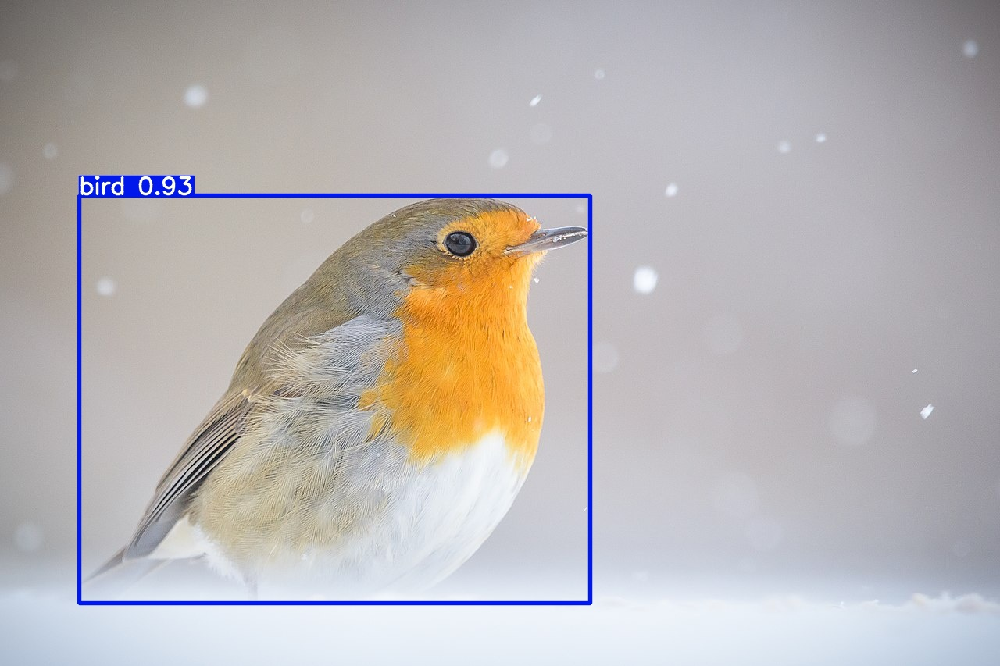

In [33]:
image_02 = 'runs/detect/exp/02_Rotkehlchen_im_Landschaftsschutzgebiet__Unterer_Neckar,_Zwischen_Heidelberg_und_Ladenburg__04.jpg'
Image(filename = image_02)

In [34]:
# Inference
results_02 = model(image_02)

# Results
results_02.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_02.xyxy[0]  # img1 predictions (tensor)
results_02.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 853x1280 1 bird
Speed: 26.1ms pre-process, 30.0ms inference, 1.3ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,118.00000,255.00000,753.00000,762.00000,0.93945,14,bird


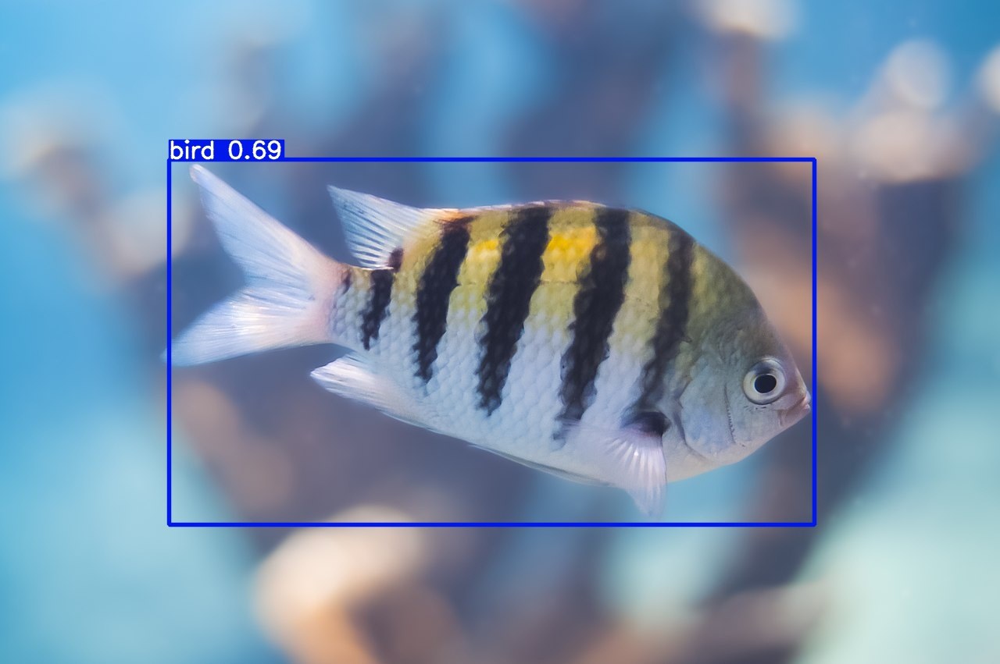

In [35]:
image_03 = 'runs/detect/exp/03_1280px-Sergeant_Major_fish_or_píntano_(Abudefduf_saxatilis)_a_species_of_damselfish_in_Curacao.jpg'
Image(filename = image_03)

In [36]:
# Inference
results_03 = model(image_03)

# Results
results_03.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_03.xyxy[0]  # img1 predictions (tensor)
results_03.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 851x1280 1 bird
Speed: 25.1ms pre-process, 29.1ms inference, 1.4ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,226.50000,210.37500,1038.00000,667.00000,0.26953,14,bird


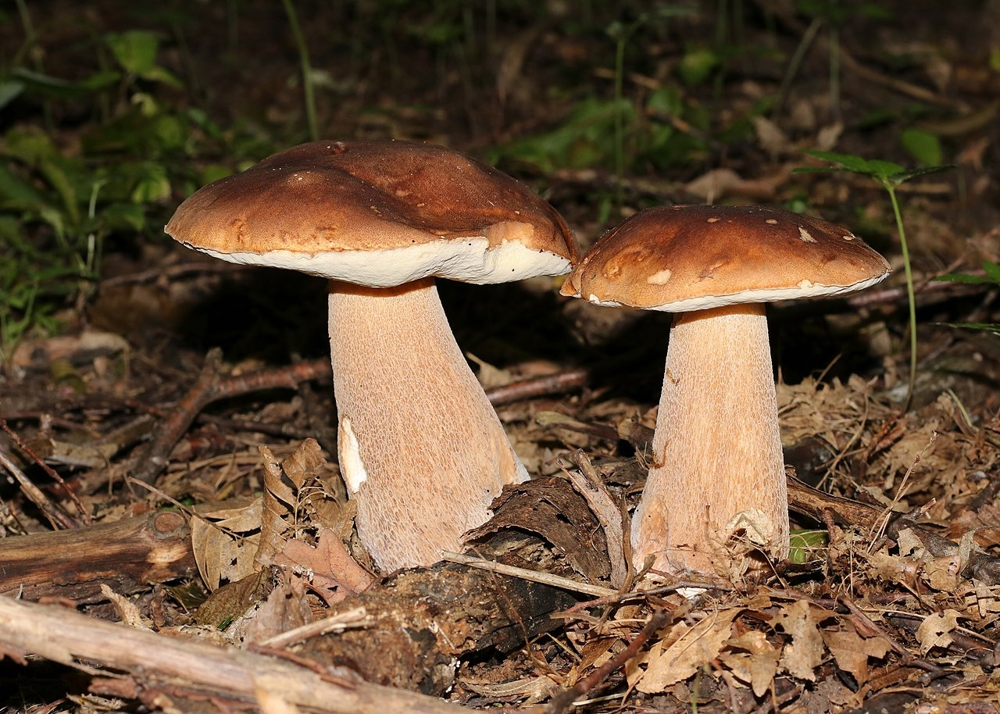

In [37]:
image_04 = 'runs/detect/exp/04_1280px-Boletus_reticulatus_2019_G03.jpg'
Image(filename = image_04)

In [38]:
# Inference
results_04 = model(image_04)

# Results
results_04.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_04.xyxy[0]  # img1 predictions (tensor)
results_04.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 914x1280 1 bird
Speed: 25.8ms pre-process, 32.5ms inference, 3.3ms NMS per image at shape (1, 3, 480, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,207.25000,179.00000,746.00000,740.00000,0.43359,14,bird


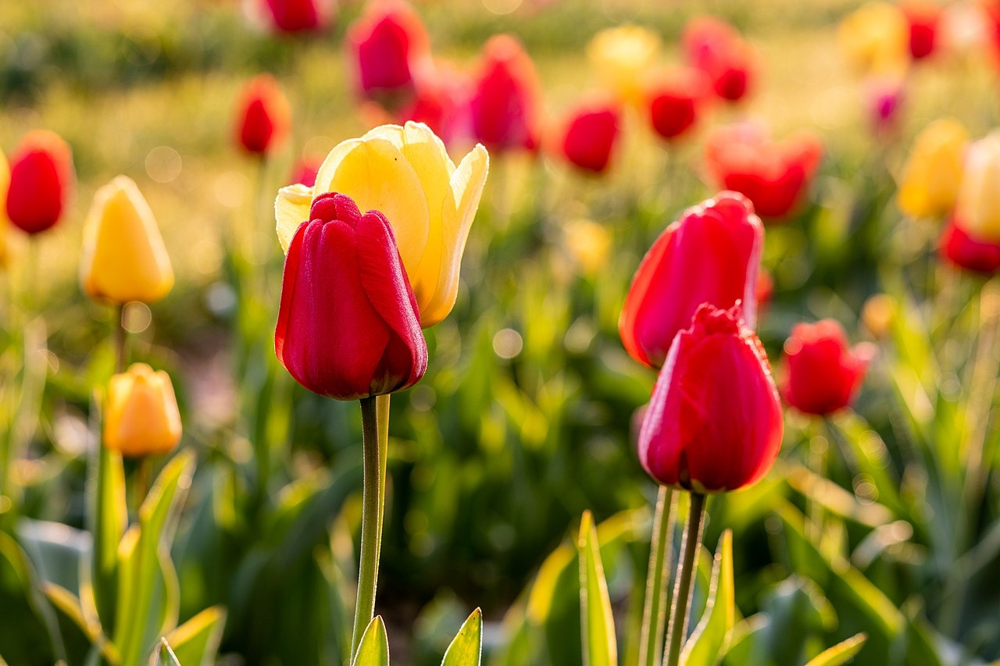

In [39]:
image_05 = 'runs/detect/exp/05_Münster,_Wolbeck,_Johannes_Blumenfelder,_Tulpen_--_2021_--_7843.jpg'
Image(filename = image_05)

In [40]:
# Inference
results_05 = model(image_05)

# Results
results_05.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_05.xyxy[0]  # img1 predictions (tensor)
results_05.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 853x1280
Speed: 25.3ms pre-process, 29.9ms inference, 0.5ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name


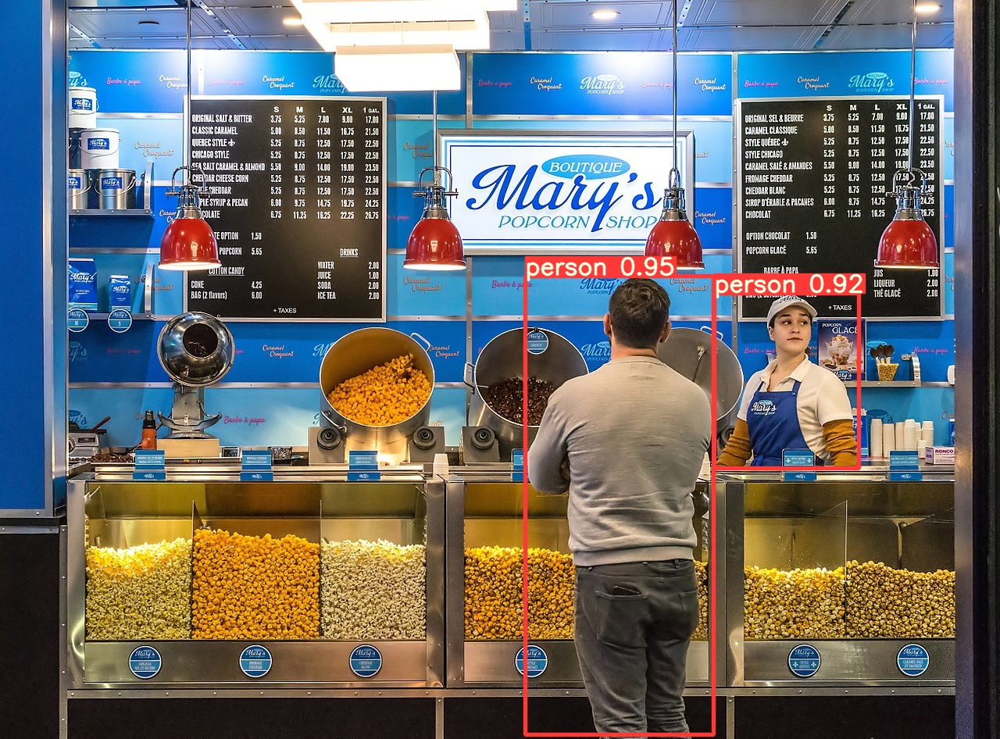

In [41]:
image_06 = 'runs/detect/exp/06_1280px-Quebec_ville,_Canada_06.jpg'
Image(filename = image_06)

In [42]:
# Inference
results_06 = model(image_06)

# Results
results_06.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_06.xyxy[0]  # img1 predictions (tensor)
results_06.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 946x1280 2 persons, 3 cups, 1 oven
Speed: 27.0ms pre-process, 30.1ms inference, 1.3ms NMS per image at shape (1, 3, 480, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,672.50000,355.75000,910.50000,937.00000,0.93701,0,person
1,917.50000,378.00000,1100.00000,600.00000,0.91553,0,person
2,1122.00000,463.50000,1150.00000,487.50000,0.43823,41,cup
3,1000.50000,572.50000,1043.00000,614.50000,0.42456,41,cup
4,82.75000,601.00000,597.00000,937.00000,0.36328,69,oven
5,1153.00000,536.50000,1177.00000,576.50000,0.26025,41,cup


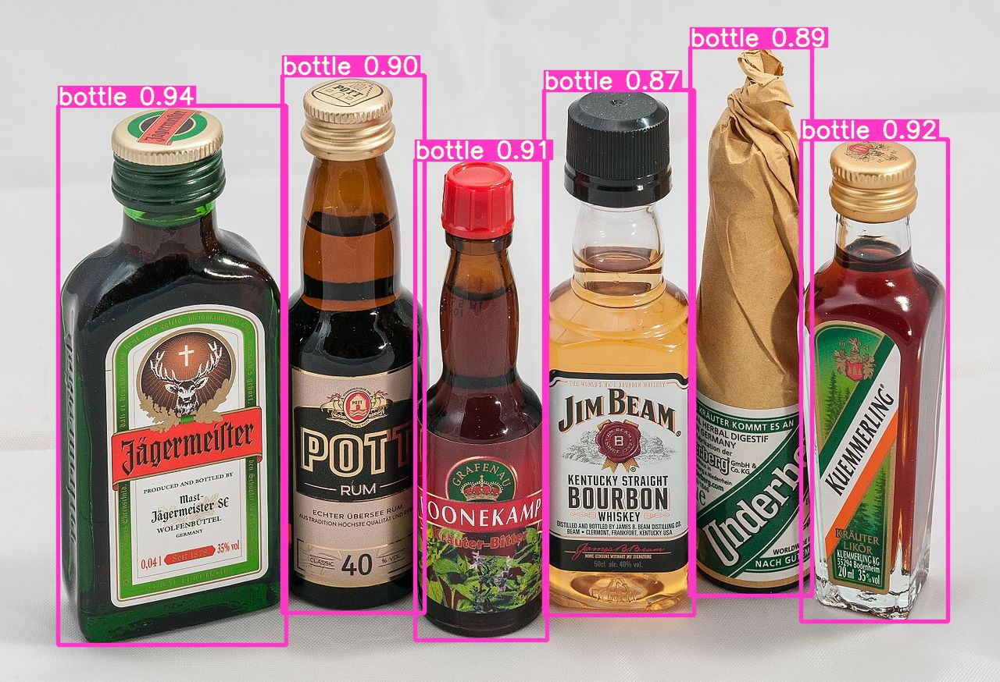

In [43]:
image_07 = 'runs/detect/exp/07_17-05-06-Miniaturen_RR79036.jpg'
Image(filename = image_07)

In [44]:
# Inference
results_07 = model(image_07)

# Results
results_07.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_07.xyxy[0]  # img1 predictions (tensor)
results_07.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 874x1280 7 bottles
Speed: 27.6ms pre-process, 30.0ms inference, 1.5ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,74.25000,135.25000,361.00000,825.00000,0.92383,39,bottle
1,542.00000,206.00000,698.00000,816.00000,0.91748,39,bottle
2,1033.00000,180.50000,1207.00000,790.00000,0.87793,39,bottle
3,369.75000,97.25000,532.00000,783.00000,0.86865,39,bottle
4,887.50000,64.50000,1029.00000,762.00000,0.84619,39,bottle
5,700.00000,118.50000,888.00000,788.00000,0.84570,39,bottle
6,719.50000,117.12500,861.50000,392.00000,0.35132,39,bottle


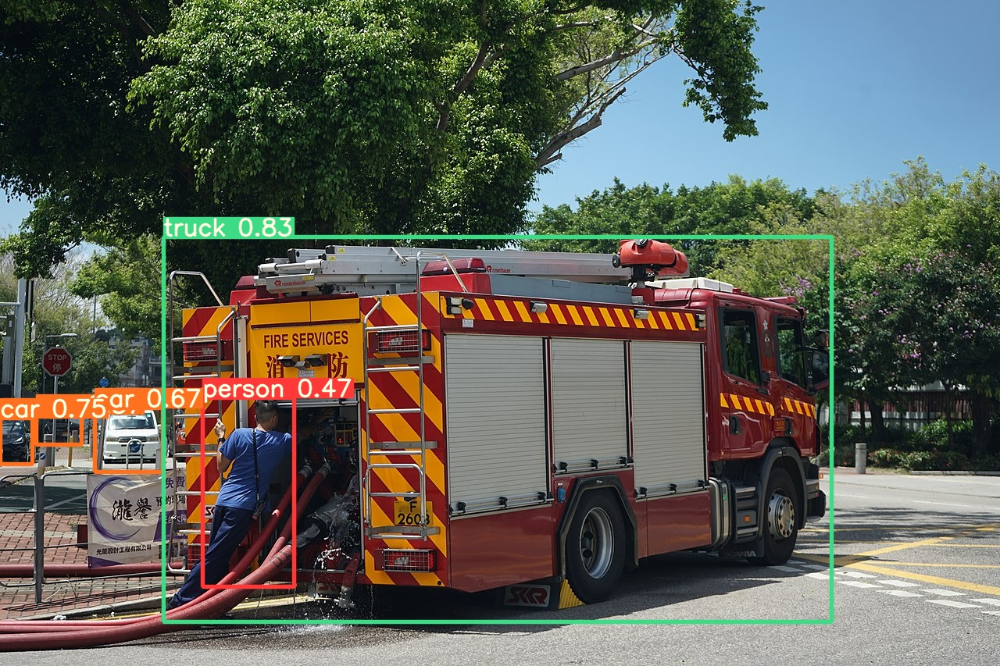

In [45]:
image_08 = 'runs/detect/exp/08_F_HLF_F2608_CPBMP.jpg'
Image(filename = image_08)

In [46]:
# Inference
results_08 = model(image_08)

# Results
results_08.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_08.xyxy[0]  # img1 predictions (tensor)
results_08.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 853x1280 1 person, 2 cars, 1 truck, 1 stop sign
Speed: 30.9ms pre-process, 29.1ms inference, 1.5ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,201.50000,304.25000,1070.00000,790.50000,0.78174,7,truck
1,127.37500,528.50000,204.62500,599.50000,0.73779,2,car
2,241.62500,512.50000,375.00000,756.50000,0.66162,0,person
3,55.43750,445.50000,91.06250,481.50000,0.47388,11,stop sign
4,2.17188,538.50000,38.81250,592.50000,0.25391,2,car


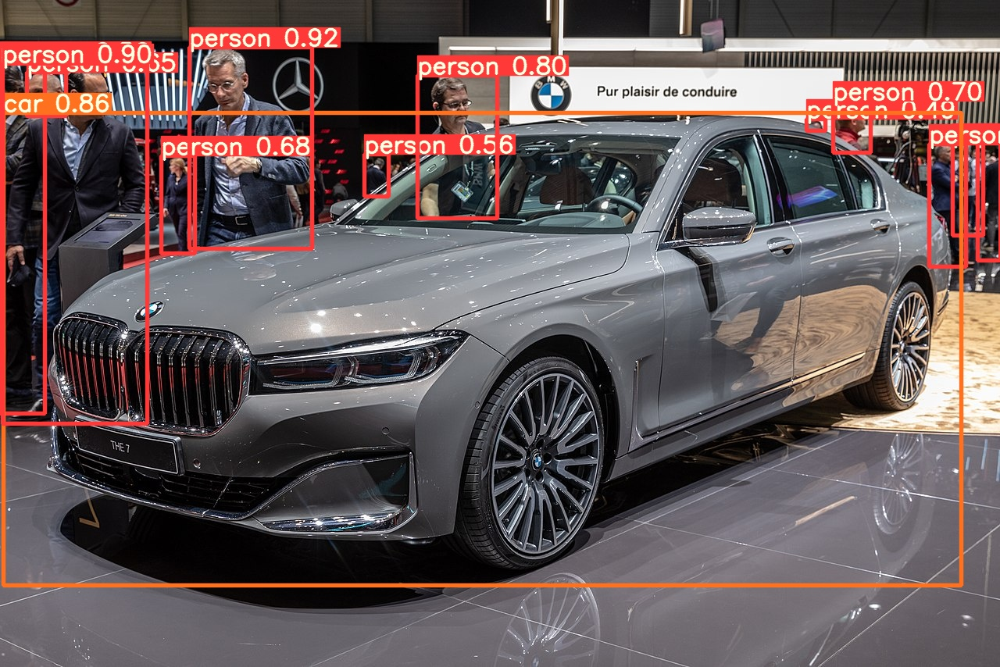

In [47]:
image_09 = 'runs/detect/exp/09_1280px-GIMS_2019,_Le_Grand-Saconnex_(GIMS0591).jpg'
Image(filename = image_09)

In [48]:
# Inference
results_09 = model(image_09)

# Results
results_09.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_09.xyxy[0]  # img1 predictions (tensor)
results_09.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 854x1280 8 persons, 1 car, 1 tie
Speed: 24.7ms pre-process, 29.1ms inference, 1.6ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,246.75000,60.81250,396.25000,314.75000,0.85107,0,person
1,9.43750,90.75000,186.00000,520.00000,0.81006,0,person
2,1.50000,150.75000,1240.00000,733.00000,0.77832,2,car
3,537.00000,97.31250,676.00000,278.25000,0.65527,0,person
4,210.25000,200.75000,240.75000,318.75000,0.61719,0,person
5,1191.00000,185.25000,1221.00000,294.75000,0.52393,0,person
6,2.79688,117.12500,50.68750,523.50000,0.40967,0,person
7,1141.00000,154.25000,1177.00000,246.50000,0.40454,0,person
8,1257.00000,188.25000,1279.00000,336.75000,0.36328,0,person
9,81.81250,159.87500,103.68750,228.12500,0.35352,27,tie


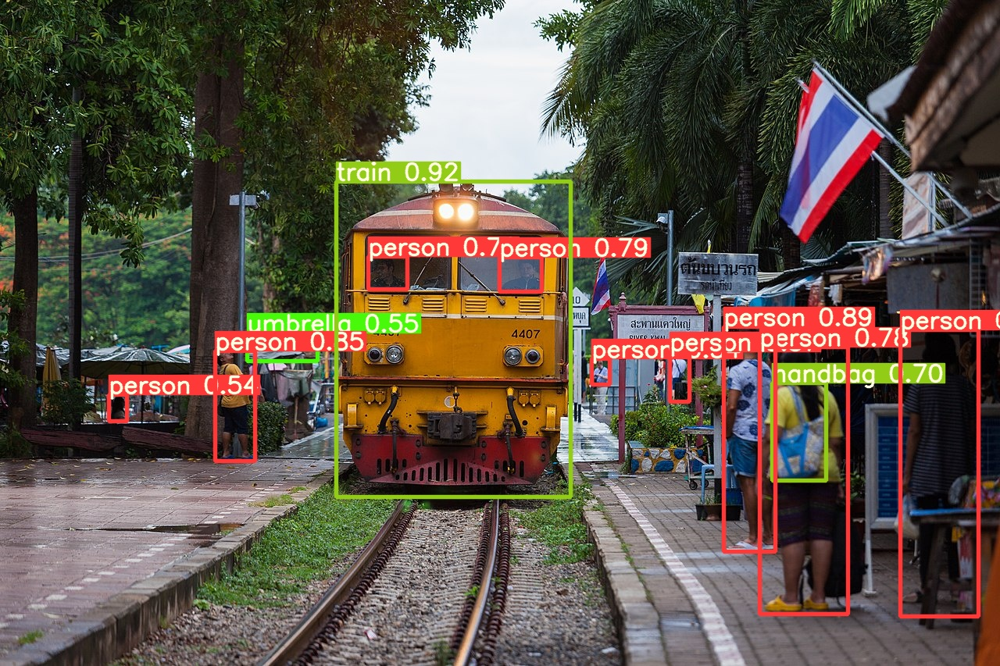

In [49]:
image_10 = 'runs/detect/exp/10_1280px-River_Kwai_Bridge_Railway_Station.jpg'
Image(filename = image_10)

In [50]:
# Inference
results_10 = model(image_10)

# Results
results_10.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_10.xyxy[0]  # img1 predictions (tensor)
results_10.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 853x1280 6 persons, 1 train, 1 handbag
Speed: 28.9ms pre-process, 29.1ms inference, 1.4ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,430.00000,239.25000,729.00000,630.50000,0.92480,6,train
1,929.50000,451.75000,983.50000,698.50000,0.75879,0,person
2,279.25000,454.75000,322.25000,586.50000,0.72119,0,person
3,971.50000,472.50000,1084.00000,785.50000,0.69775,0,person
4,995.00000,494.00000,1057.00000,614.00000,0.64502,26,handbag
5,1156.00000,429.50000,1252.00000,786.50000,0.64307,0,person
6,474.50000,331.25000,513.50000,367.75000,0.53955,0,person
7,647.50000,334.00000,690.50000,371.50000,0.33130,0,person


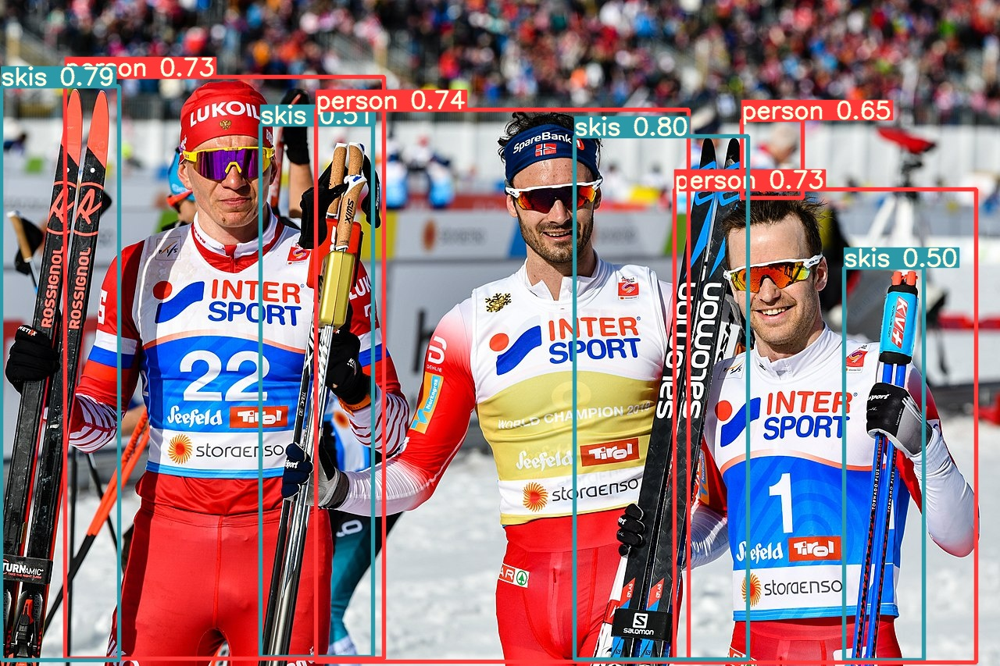

In [51]:
image_11 = 'runs/detect/exp/11_1280px-20190303_FIS_NWSC_Seefeld_Men_CC_50km_Mass_Start_850_7159.jpg'
Image(filename = image_11)

In [52]:
# Inference
results_11 = model(image_11)

# Results
results_11.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_11.xyxy[0]  # img1 predictions (tensor)
results_11.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 853x1280 4 persons, 4 skiss
Speed: 27.6ms pre-process, 29.2ms inference, 3.8ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,77.62500,98.50000,487.50000,840.00000,0.82080,0,person
1,414.00000,143.75000,872.00000,844.50000,0.80615,0,person
2,2.06250,101.00000,153.75000,839.00000,0.75391,30,skis
3,332.50000,183.00000,478.00000,834.00000,0.69873,30,skis
4,834.00000,254.50000,1244.00000,841.50000,0.69092,0,person
5,765.00000,250.75000,953.00000,837.50000,0.58643,30,skis
6,1085.00000,340.25000,1179.00000,840.50000,0.46265,30,skis
7,6.25781,167.87500,36.15625,201.12500,0.31982,0,person


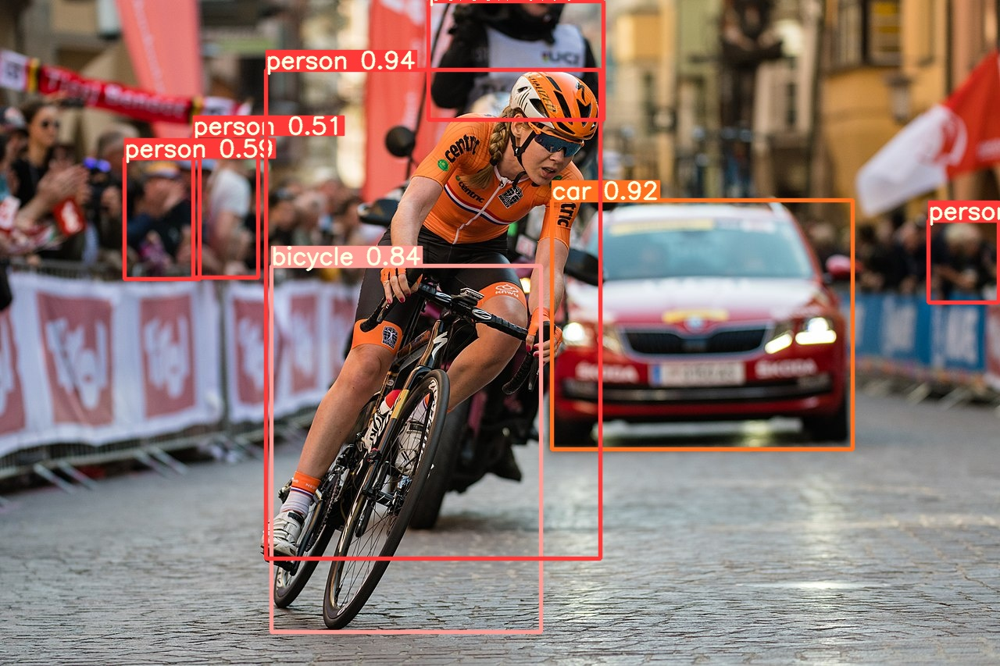

In [53]:
image_12 = 'runs/detect/exp/12_1280px-20180929_UCI_Road_World_Championships_Innsbruck_Women_Elite_Road_Race_Anna_van_der_Breggen_850_0990.jpg'
Image(filename = image_12)

In [54]:
# Inference
results_12 = model(image_12)

# Results
results_12.print()  # or .show(), .save(), .crop(), .pandas(), etc.
results_12.xyxy[0]  # img1 predictions (tensor)
results_12.pandas().xyxy[0]  # img1 predictions (pandas)

image 1/1: 853x1280 7 persons, 1 bicycle, 1 car, 1 umbrella
Speed: 25.0ms pre-process, 29.1ms inference, 1.4ms NMS per image at shape (1, 3, 448, 640)


,xmin,ymin,xmax,ymax,confidence,class,name
0,345.50000,94.75000,766.50000,706.50000,0.90918,0,person
1,704.00000,255.50000,1088.00000,569.50000,0.89795,2,car
2,343.00000,345.00000,685.00000,805.00000,0.85449,1,bicycle
3,162.25000,205.50000,243.50000,350.50000,0.49390,0,person
4,549.00000,3.43750,765.00000,151.00000,0.47827,0,person
5,370.25000,245.25000,421.75000,314.75000,0.44214,0,person
6,262.00000,204.00000,326.00000,350.00000,0.42676,0,person
7,2.00000,130.00000,88.12500,286.25000,0.37134,0,person
8,1092.00000,21.87500,1280.00000,280.50000,0.34497,25,umbrella
9,1.25000,176.50000,119.12500,335.00000,0.33887,0,person
